<a href="https://colab.research.google.com/github/Crepopcorn/sit_detection_project/blob/main/custom_body_detetction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **YOLOv8**

In [1]:
!nvidia-smi

Sat Mar  9 21:36:46 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA A100-SXM4-40GB          Off | 00000000:00:04.0 Off |                    0 |
| N/A   33C    P0              46W / 400W |      2MiB / 40960MiB |      0%      Default |
|                                         |                      |             Disabled |
+-----------------------------------------+----------------------+--

In [2]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 720.1/720.1 kB 14.6 MB/s eta 0:00:00


In [3]:
from google.colab import drive
drive.mount('/content/drive')
# check the uploaded dataset
!ls '/content/drive/My Drive/custom_upper_body'
!ls '/content/drive/My Drive/custom_upper_body/train'
!ls '/content/drive/My Drive/custom_upper_body/valid'

Mounted at /content/drive
data.yaml  obj.data  obj.names	train  train.txt  valid
images	labels
images	labels


In [4]:
import timeit
from ultralytics import YOLO

start = timeit.default_timer()

model = YOLO("yolov8m.pt")
yaml_file = "/content/drive/My Drive/custom_upper_body/data.yaml"
results = model.train(data=yaml_file, epochs=50, imgsz=600)  # train the model

stop = timeit.default_timer()
print('Head detector Runtime (seconds): ', stop - start)

100%|██████████| 49.7M/49.7M [00:00<00:00, 381MB/s]


Ultralytics YOLOv8.1.25 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/drive/My Drive/custom_upper_body/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=600, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, s

100%|██████████| 755k/755k [00:00<00:00, 96.5MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1      1392  ultralytics.nn.modules.conv.Conv             [3, 48, 3, 2]                 
  1                  -1  1     41664  ultralytics.nn.modules.conv.Conv             [48, 96, 3, 2]                
  2                  -1  2    111360  ultralytics.nn.modules.block.C2f             [96, 96, 2, True]             
  3                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
  4                  -1  4    813312  ultralytics.nn.modules.block.C2f             [192, 192, 4, True]           
  5                  -1  1    664320  ultralytics.nn.modules.conv.Conv             [192, 384, 3, 2]              
  6                  -1  4   3248640  ultralytics.nn.modules.block.C2f             [384, 384, 4, True]           
  7                  -1  1   1991808  ultralytics

100%|██████████| 6.23M/6.23M [00:00<00:00, 274MB/s]


AMP: checks passed ✅
WARNING ⚠️ imgsz=[600] must be multiple of max stride 32, updating to [608]


train: Scanning /content/drive/My Drive/custom_upper_body/train/labels... 500 images, 92 backgrounds, 0 corrupt: 100%|██████████| 500/500 [00:38<00:00, 13.08it/s]


train: New cache created: /content/drive/My Drive/custom_upper_body/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/My Drive/custom_upper_body/valid/labels... 46 images, 13 backgrounds, 0 corrupt: 100%|██████████| 46/46 [00:05<00:00,  7.68it/s]

val: New cache created: /content/drive/My Drive/custom_upper_body/valid/labels.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 608 train, 608 val
Using 8 dataloader workers
Logging results to runs/detect/train
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      6.81G        1.7      2.181      1.742         19        608: 100%|██████████| 32/32 [00:08<00:00,  3.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all         46         53      0.944      0.321      0.502      0.208



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      7.03G      1.763      1.733      1.792         10        608: 100%|██████████| 32/32 [00:04<00:00,  7.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.90it/s]

                   all         46         53    0.00946      0.264    0.00687    0.00248



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      7.04G      1.871      1.868      1.867          7        608: 100%|██████████| 32/32 [00:04<00:00,  7.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.69it/s]

                   all         46         53    0.00367      0.226    0.00212   0.000635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      7.03G      1.876       1.79      1.842         11        608: 100%|██████████| 32/32 [00:04<00:00,  7.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  9.00it/s]

                   all         46         53    0.00536      0.547    0.00467    0.00161



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      7.03G      1.803      1.713      1.798         12        608: 100%|██████████| 32/32 [00:04<00:00,  7.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.88it/s]

                   all         46         53    0.00179       0.34    0.00121   0.000473



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      7.03G      1.734      1.661      1.785          8        608: 100%|██████████| 32/32 [00:04<00:00,  7.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.52it/s]

                   all         46         53      0.445      0.472      0.461      0.228



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      7.02G      1.707      1.594      1.755         12        608: 100%|██████████| 32/32 [00:04<00:00,  7.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.51it/s]

                   all         46         53       0.34      0.453      0.308      0.117



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      7.03G      1.682      1.595      1.732         16        608: 100%|██████████| 32/32 [00:04<00:00,  7.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  9.49it/s]

                   all         46         53      0.448      0.358      0.307      0.103



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      7.02G      1.706      1.569      1.731         15        608: 100%|██████████| 32/32 [00:04<00:00,  7.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  9.45it/s]

                   all         46         53      0.673      0.566       0.62      0.301



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      7.02G      1.655      1.533      1.743          7        608: 100%|██████████| 32/32 [00:04<00:00,  7.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.15it/s]

                   all         46         53      0.711      0.453      0.562      0.253



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      7.02G      1.616      1.417      1.696         23        608: 100%|██████████| 32/32 [00:04<00:00,  7.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  9.08it/s]

                   all         46         53      0.353       0.34      0.255       0.13



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      7.03G      1.601      1.414      1.684         13        608: 100%|██████████| 32/32 [00:04<00:00,  7.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.92it/s]

                   all         46         53      0.676      0.566      0.621      0.235



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      7.03G      1.561      1.392      1.664         15        608: 100%|██████████| 32/32 [00:04<00:00,  7.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.98it/s]

                   all         46         53      0.667       0.53      0.581      0.277



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      7.02G      1.481      1.251      1.589          8        608: 100%|██████████| 32/32 [00:04<00:00,  7.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.75it/s]

                   all         46         53      0.638      0.396      0.475      0.177



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      7.02G      1.527      1.268      1.607         20        608: 100%|██████████| 32/32 [00:04<00:00,  7.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  9.03it/s]

                   all         46         53      0.655      0.574       0.62      0.319



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      7.02G      1.525      1.346      1.619          6        608: 100%|██████████| 32/32 [00:04<00:00,  7.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  9.03it/s]

                   all         46         53      0.658      0.679      0.661      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      7.02G      1.424      1.179      1.538         28        608: 100%|██████████| 32/32 [00:04<00:00,  7.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.23it/s]

                   all         46         53       0.79      0.568      0.699      0.327



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      7.02G      1.417      1.168      1.575          6        608: 100%|██████████| 32/32 [00:04<00:00,  7.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  9.18it/s]

                   all         46         53      0.716      0.666      0.766      0.369



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      7.02G      1.415      1.199      1.563         12        608: 100%|██████████| 32/32 [00:04<00:00,  7.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.43it/s]

                   all         46         53      0.627      0.736      0.684      0.306



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      7.03G      1.387      1.116        1.5         23        608: 100%|██████████| 32/32 [00:04<00:00,  7.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  9.72it/s]

                   all         46         53        0.7      0.661      0.675      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      7.03G      1.429      1.123      1.525         12        608: 100%|██████████| 32/32 [00:04<00:00,  7.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.01it/s]

                   all         46         53      0.671      0.679      0.647      0.268



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      7.02G      1.391      1.156      1.513          8        608: 100%|██████████| 32/32 [00:04<00:00,  7.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  9.96it/s]

                   all         46         53      0.799      0.623      0.748      0.359



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      7.03G      1.366      1.105      1.483         18        608: 100%|██████████| 32/32 [00:04<00:00,  7.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  9.04it/s]

                   all         46         53      0.697      0.736      0.736      0.362



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      7.02G      1.346      1.125      1.501          9        608: 100%|██████████| 32/32 [00:04<00:00,  7.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.68it/s]

                   all         46         53      0.808      0.642      0.775      0.385



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      7.02G      1.307      1.029      1.429         21        608: 100%|██████████| 32/32 [00:04<00:00,  7.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.80it/s]

                   all         46         53      0.707      0.728      0.734      0.375



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      7.03G       1.31      1.036       1.46         16        608: 100%|██████████| 32/32 [00:04<00:00,  7.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.86it/s]

                   all         46         53      0.784      0.717      0.775      0.372



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      7.02G       1.28      1.012      1.435         20        608: 100%|██████████| 32/32 [00:04<00:00,  7.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.96it/s]

                   all         46         53      0.779      0.731      0.762      0.351



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      7.02G      1.206     0.9466      1.386         14        608: 100%|██████████| 32/32 [00:04<00:00,  7.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.30it/s]

                   all         46         53      0.773      0.708      0.792      0.375



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      7.03G      1.213     0.9449      1.415         15        608: 100%|██████████| 32/32 [00:04<00:00,  7.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.96it/s]

                   all         46         53      0.803       0.66      0.766      0.379



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      7.03G       1.19     0.9263      1.378         13        608: 100%|██████████| 32/32 [00:04<00:00,  7.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  9.22it/s]

                   all         46         53       0.87      0.758      0.855      0.379



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      7.01G      1.176     0.9036       1.37         25        608: 100%|██████████| 32/32 [00:04<00:00,  7.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  9.63it/s]

                   all         46         53        0.8      0.755      0.783      0.413



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      7.02G      1.156      0.895      1.363         11        608: 100%|██████████| 32/32 [00:04<00:00,  7.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.93it/s]

                   all         46         53       0.82      0.687      0.765      0.389



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      7.02G      1.129     0.8809      1.331         14        608: 100%|██████████| 32/32 [00:04<00:00,  7.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.33it/s]

                   all         46         53      0.746      0.774      0.756      0.397



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      7.03G      1.147     0.8853      1.358         14        608: 100%|██████████| 32/32 [00:04<00:00,  7.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  9.79it/s]

                   all         46         53      0.904      0.717      0.813      0.441



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      7.02G       1.07     0.8062      1.313         13        608: 100%|██████████| 32/32 [00:04<00:00,  7.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  9.36it/s]

                   all         46         53      0.823      0.701      0.802      0.444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      7.02G      1.058     0.7913      1.289         17        608: 100%|██████████| 32/32 [00:04<00:00,  7.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.71it/s]

                   all         46         53      0.849      0.792      0.831      0.401



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      7.02G      1.073     0.7862      1.296         12        608: 100%|██████████| 32/32 [00:04<00:00,  7.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.56it/s]

                   all         46         53      0.767      0.869      0.866      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      7.02G      1.045     0.7775      1.271         22        608: 100%|██████████| 32/32 [00:04<00:00,  7.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  9.36it/s]

                   all         46         53      0.792      0.679      0.795      0.409



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      7.02G      1.053     0.7997      1.294          9        608: 100%|██████████| 32/32 [00:04<00:00,  7.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.52it/s]

                   all         46         53      0.789      0.774      0.826      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      7.03G     0.9925     0.7586      1.251         15        608: 100%|██████████| 32/32 [00:04<00:00,  7.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  9.58it/s]

                   all         46         53      0.755      0.755      0.797      0.362


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      7.02G     0.9922     0.6491      1.275          5        608: 100%|██████████| 32/32 [00:05<00:00,  5.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  9.59it/s]

                   all         46         53      0.972      0.698      0.797      0.385



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      7.02G     0.9437     0.6216      1.235          4        608: 100%|██████████| 32/32 [00:04<00:00,  7.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  9.04it/s]

                   all         46         53      0.901      0.698      0.825      0.401



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      7.02G     0.9196     0.5721      1.211         12        608: 100%|██████████| 32/32 [00:04<00:00,  7.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  9.03it/s]

                   all         46         53      0.854       0.77      0.847      0.483



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      7.02G     0.9202     0.5696      1.222          6        608: 100%|██████████| 32/32 [00:04<00:00,  7.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  9.63it/s]

                   all         46         53      0.814      0.736       0.85      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      7.03G     0.8672     0.5521      1.185         11        608: 100%|██████████| 32/32 [00:04<00:00,  7.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.50it/s]

                   all         46         53      0.868      0.746      0.865      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      7.02G     0.8697     0.5385      1.183          5        608: 100%|██████████| 32/32 [00:04<00:00,  7.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  9.47it/s]

                   all         46         53      0.875      0.698      0.809       0.43



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      7.02G     0.8149     0.5052      1.146          8        608: 100%|██████████| 32/32 [00:04<00:00,  7.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.59it/s]

                   all         46         53      0.825      0.755      0.791      0.419



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      7.02G     0.7836     0.4977       1.12          6        608: 100%|██████████| 32/32 [00:04<00:00,  7.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  9.35it/s]

                   all         46         53      0.825      0.755      0.808      0.436



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      7.03G     0.7751     0.4766      1.129          8        608: 100%|██████████| 32/32 [00:04<00:00,  7.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  9.22it/s]

                   all         46         53      0.882      0.717        0.8      0.436



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      7.02G     0.7785     0.4812      1.132          7        608: 100%|██████████| 32/32 [00:04<00:00,  7.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.64it/s]

                   all         46         53      0.832      0.755      0.802      0.437



50 epochs completed in 0.083 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/train/weights/best.pt, 52.0MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.1.25 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
Model summary (fused): 218 layers, 25840339 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.24it/s]


                   all         46         53      0.854      0.771      0.848      0.484
Speed: 0.1ms preprocess, 1.3ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to runs/detect/train
Head detector Runtime (seconds):  370.82053310699996


In [5]:
results = model.val()

Ultralytics YOLOv8.1.25 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
Model summary (fused): 218 layers, 25840339 parameters, 0 gradients, 78.7 GFLOPs


val: Scanning /content/drive/My Drive/custom_upper_body/valid/labels.cache... 46 images, 13 backgrounds, 0 corrupt: 100%|██████████| 46/46 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.34it/s]


                   all         46         53      0.888      0.751      0.848      0.484
Speed: 0.1ms preprocess, 36.7ms inference, 0.0ms loss, 0.7ms postprocess per image
Results saved to runs/detect/train2


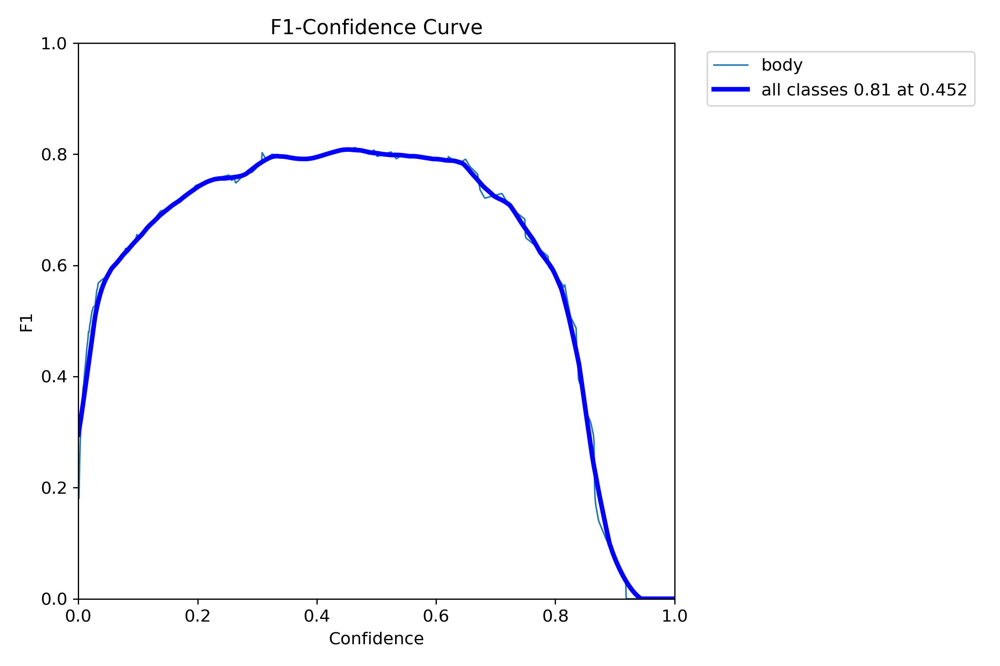

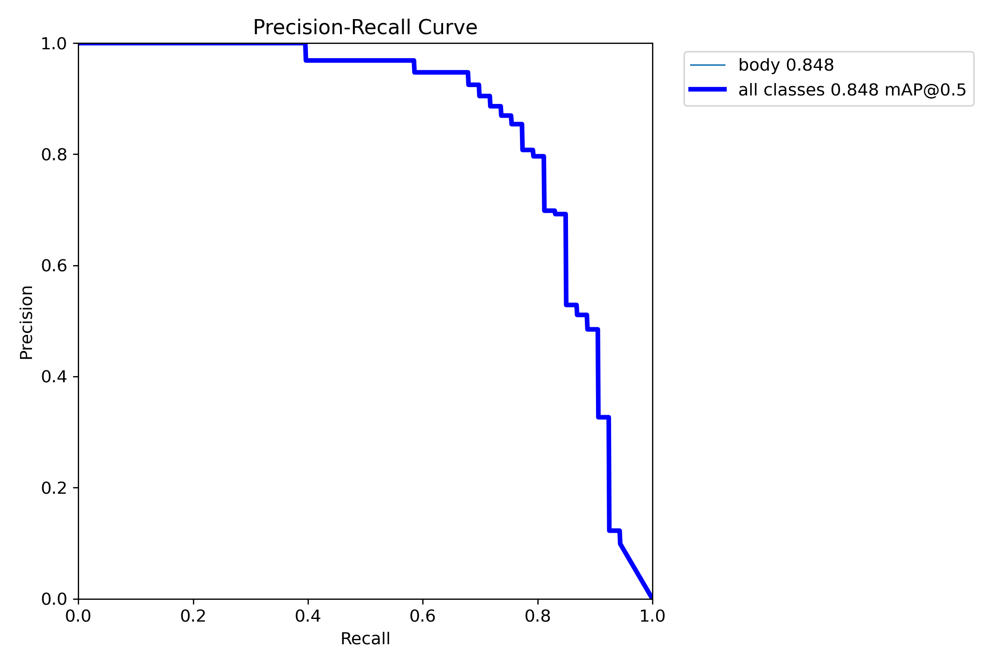

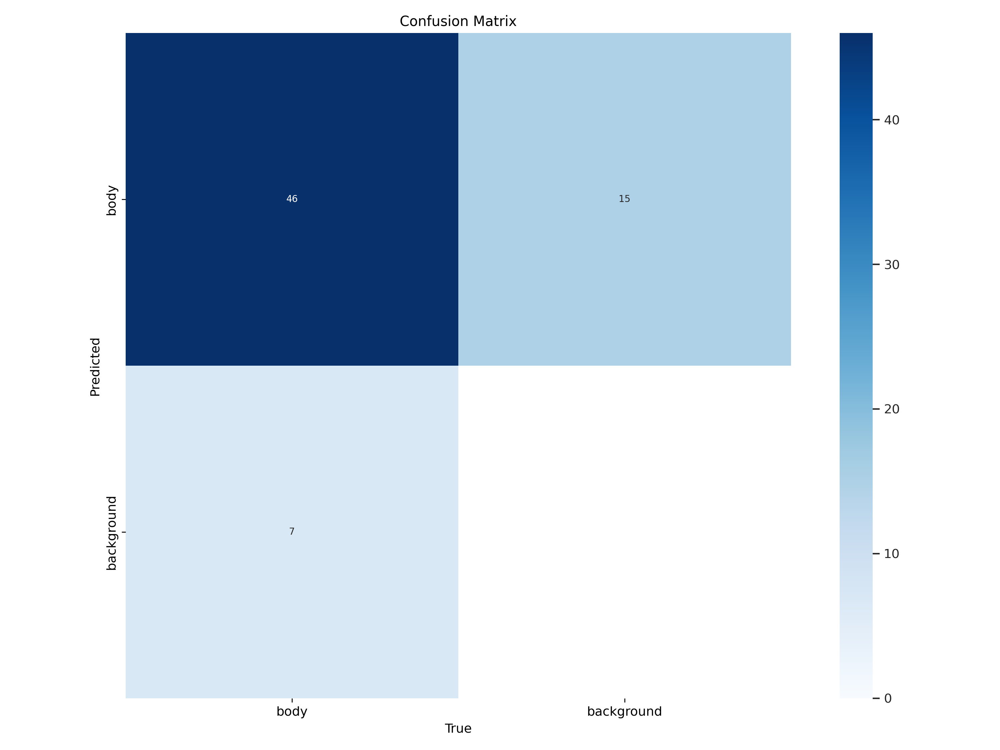

In [6]:
# dislaying train data metrics

from IPython.display import Image
from IPython.display import display
x = Image(filename='runs/detect/train/F1_curve.png')
y = Image(filename='runs/detect/train/PR_curve.png')
z = Image(filename='runs/detect/train/confusion_matrix.png')
display(x, y,z)

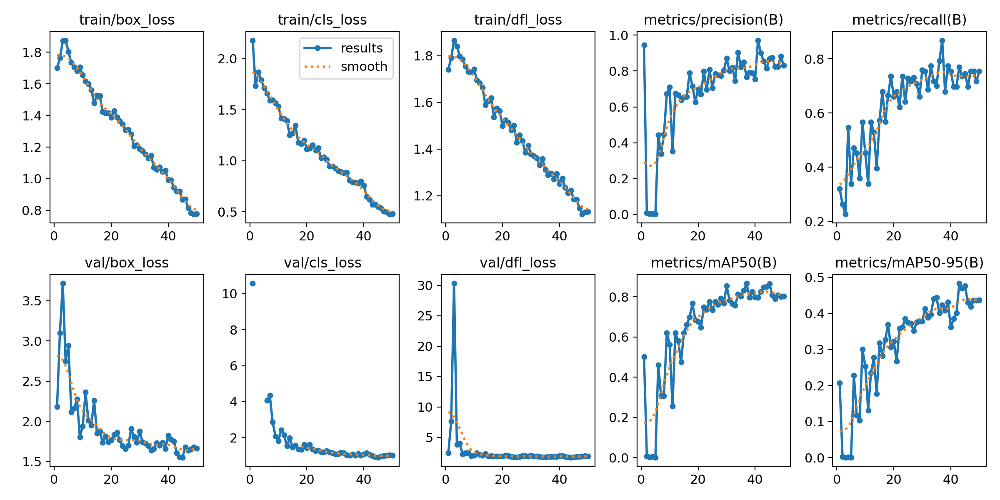

In [7]:
Image(filename=f'/content/runs/detect/train/results.png', width = 600)

# **Model Weight and Analysis**

In [8]:
import locale
print(locale.getpreferredencoding())

ANSI_X3.4-1968


In [9]:
import locale
def getpreferredencoding(do_setlocale = True):
    return "UTF-8"
locale.getpreferredencoding = getpreferredencoding

In [10]:
# checking the latest trained files
!ls 'runs/detect/train/weights'

best.pt  last.pt


In [11]:
# loading the trianed model
model = YOLO("runs/detect/train/weights/best.pt")

In [12]:
!yolo task=detect mode=predict model="runs/detect/train/weights/best.pt" source='/content/drive/My Drive/Camera Roll/side_video.mp4'

Ultralytics YOLOv8.1.25 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
Model summary (fused): 218 layers, 25840339 parameters, 0 gradients, 78.7 GFLOPs

video 1/1 (1/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 352x608 1 body, 163.9ms
video 1/1 (2/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 352x608 1 body, 10.5ms
video 1/1 (3/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 352x608 1 body, 10.2ms
video 1/1 (4/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 352x608 1 body, 10.0ms
video 1/1 (5/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 352x608 1 body, 11.3ms
video 1/1 (6/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 352x608 1 body, 10.2ms
video 1/1 (7/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 352x608 1 body, 10.1ms
video 1/1 (8/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 352x608 1 body, 10.1ms
video 1/1 (9/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 352

In [13]:
!ls 'runs/detect/predict'

side_video.avi


In [14]:
from moviepy.editor import *

path="runs/detect/predict/side_video.avi"

clip=VideoFileClip(path)
clip.ipython_display(width=600)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


In [15]:
!yolo task=detect mode=predict model="runs/detect/train/weights/best.pt" source='/content/drive/My Drive/Camera Roll/sit_video.mp4'

Ultralytics YOLOv8.1.25 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
Model summary (fused): 218 layers, 25840339 parameters, 0 gradients, 78.7 GFLOPs

video 1/1 (1/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 352x608 (no detections), 151.7ms
video 1/1 (2/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 352x608 (no detections), 11.2ms
video 1/1 (3/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 352x608 (no detections), 10.0ms
video 1/1 (4/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 352x608 (no detections), 10.0ms
video 1/1 (5/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 352x608 (no detections), 9.8ms
video 1/1 (6/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 352x608 (no detections), 9.9ms
video 1/1 (7/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 352x608 (no detections), 9.9ms
video 1/1 (8/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 352x608 (no detections), 10.0ms
video 1/1 (9

In [16]:
!ls 'runs/detect/predict2'

sit_video.avi


In [17]:
from moviepy.editor import *

path="runs/detect/predict2/sit_video.avi"

clip=VideoFileClip(path)
clip.ipython_display(width=600)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



t:  99%|█████████▉| 301/303 [00:01<00:00, 156.11it/s, now=None]WARNING:py.warnings:/usr/local/lib/python3.10/dist-packages/moviepy/video/io/ffmpeg_reader.py:123: UserWarning: Warning: in file runs/detect/predict2/sit_video.avi, 2764800 bytes wanted but 0 bytes read,at frame 302/303, at time 10.07/10.07 sec. Using the last valid frame instead.
  warnings.warn("Warning: in file %s, "%(self.filename)+

                                                               

Moviepy - Done !
Moviepy - video ready __temp__.mp4


In [18]:
import shutil

shutil.copy("runs/detect/train/weights/best.pt", "/content/drive/My Drive/custom_upper_body/")

'/content/drive/My Drive/custom_upper_body/best.pt'